In [1]:
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm

In [2]:
def linear(train, test):
    return np.dot(train, test.T)

def polynomial(train, test, power=2):
    return (np.dot(train, test.T) + 1) ** power

def gauss(train, test, beta=1):
    return math.exp(-beta * np.linalg.norm(train - test) ** 2)

kernel_funcs = [linear, polynomial, gauss]
c_var = [0.05, 0.1, 0.5, 1.0, 5.0, 10.0, 50.0, 100.0]
power_var = [2, 3, 4, 5]
beta_var = [1, 2, 3, 4, 5]
lr_var = [1e-3, 1e-4, 1e-5, 1e-6, 1e-7, 1e-8, 1e-9, 1e-10]

In [3]:
def read_dataset(file_name):
    data = pd.read_csv(file_name)
    features = data.values.T[:-1].T
    labels = data.values.T[-1].T
    for i, v in enumerate(labels):
        labels[i] = 1 if v == 'P' else -1
    
    return np.mat(features), np.mat(labels)

In [4]:
dataset_name = "geyser.csv"

features, labels = read_dataset(dataset_name)

In [5]:
class Data:
    def __init__(self, features, labels):
        self.x = features
        self.y = labels
        self.x_T = features.T
        self.y_T = labels.T

        e = self.x * self.x_T
        labels = self.y_T * self.y
        self.factors = labels * e

In [6]:
class Predictor:
    def __init__(self, data, c):
        self.data = data
        self.c = c
        self.a = np.matrix(np.random.normal(0, 0.01, (1, features.shape[0])))

    def gradient_descent(self, epoch_count, learning_rate=1e-10):
        for i in range(epoch_count):
            self.__update_a(learning_rate)
        
        self.__calculate_w0()

    def __update_a(self, learning_rate):
        self.a = self.a - ((self.a * self.data.factors.T - 1) * learning_rate) # gradient step
        self.a = self.a - np.dot(self.a, self.data.y_T) / np.dot(self.data.y, self.data.y_T) * self.data.y # projection

        np.apply_along_axis(lambda el : max(0.0, min(el, self.c)), 0, self.a) # regularisation

    def __calculate_w0(self):
        w = np.mat(np.zeros(shape=(1, self.data.x.shape[1])))

        for i, row in enumerate(self.data.x):
            w = w + self.a.item(i) * self.data.y.item(i) * row

        self.w0 = (w * self.data.x_T - self.data.y).mean()

    
    def predict(self, test, kernel, power):
        sum = 0
        for i in range(self.data.x.shape[0]):
            sum += self.a.item(i) * self.data.y.item(i) * (kernel(self.data.x[i], test, power))
        sum -= self.w0

        return np.sign(sum)

    def set_params(self, a, w0):
        self.a = a
        self.w0 = w0

In [7]:
def test(kernel_func):
    data = Data(features, labels)
    
    max_acc = 0
    for lr in lr_var:
        for c in tqdm(c_var):
            for power in power_var:
                acc = 0
                predictor = Predictor(data, c)
                predictor.gradient_descent(2500, lr)

                for i in range(labels.shape[1]):
                    if predictor.predict(features[i], kernel_func, power) == labels.item(i):
                        acc += 1
                    
                if (acc > max_acc):
                    max_c = c
                    max_acc = acc
                    max_lr = lr
                    max_a = predictor.a
                    max_w0 = predictor.w0
                    max_power = power

    return max_acc / labels.shape[1] * 100, max_c, max_lr, max_a, max_w0, max_power

In [8]:
acc, c, lr, a, w0, beta = test(polynomial)

100%|██████████| 8/8 [04:37<00:00, 34.68s/it]


In [206]:
with open("result.txt", "a") as f:
    a_res = a.tolist()[0]

    for el in a_res:
        f.write(str(el))
        f.write(' ')
    
    f.write("\n")
    f.write(str(w0))

100%|██████████| 225/225 [01:14<00:00,  3.01it/s]


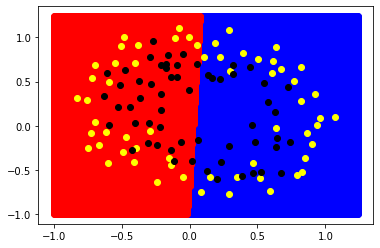

In [157]:
# Chips Linear

100%|██████████| 225/225 [01:56<00:00,  1.93it/s]


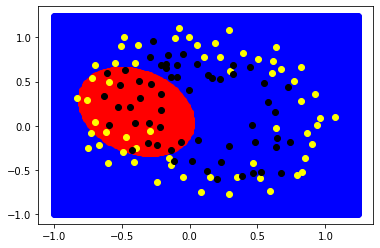

In [146]:
# Chips Polynomial

100%|██████████| 225/225 [01:11<00:00,  3.13it/s]


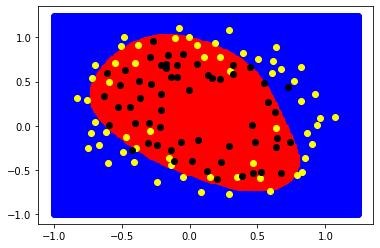

In [147]:
# Chips Gauss

100%|██████████| 260/260 [00:42<00:00,  6.09it/s]


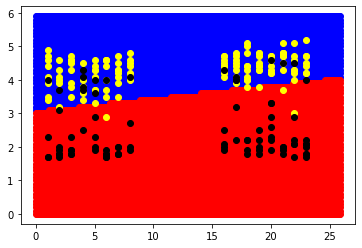

In [175]:
# Geyser Linear

100%|██████████| 260/260 [01:11<00:00,  3.63it/s]


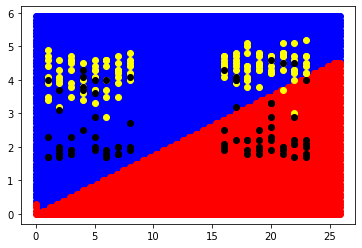

In [196]:
# Geyser Polynomial

100%|██████████| 260/260 [00:42<00:00,  6.18it/s]


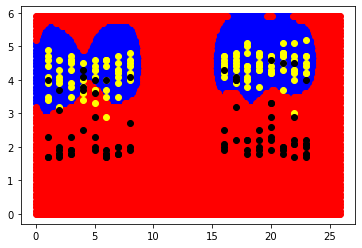

In [212]:
# Geyser Gauss

In [ ]:
data = Data(features, labels)
predictor = Predictor(data, 1)
predictor.set_params(a, w0)

x = [i / 10 for i in range(260)]
y = [i / 10 for i in range(60)]

upper_x = []
upper_y = []
lower_x = []
lower_y = []

for i in tqdm(x):
    for j in y:
        if predictor.predict(np.mat([i, j]), polynomial, 3) == 1:
            lower_x += [i]
            lower_y += [j]
        else:
            upper_x += [i]
            upper_y += [j]

plt.scatter(upper_x, upper_y, color="blue")
plt.scatter(lower_x, lower_y, color="red")


upper_x = []
upper_y = []
lower_x = []
lower_y = []

for i in range(labels.shape[1]):
    if labels.item(i) == 1:
        lower_x += [features[i].flat[0]]
        lower_y += [features[i].flat[1]]
    else:
        upper_x += [features[i].flat[0]]
        upper_y += [features[i].flat[1]]

plt.scatter(upper_x, upper_y, color="yellow")
plt.scatter(lower_x, lower_y, color="black")